In [2]:
import scipy.io
import pandas as pd

import os
import shutil
import pickle
import numpy as np
import pandas as pd
from datetime import datetime
from pathlib import Path
from contextlib import redirect_stdout
import itertools
from PIL import Image
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [11]:
train_path = Path('../cars/cars_train/')
test_path = Path('../cars/cars_test/')

cars_meta = scipy.io.loadmat('cars_meta.mat')
cars_train_annos = scipy.io.loadmat('cars_train_annos.mat')
cars_test_annos = scipy.io.loadmat('cars_test_annos.mat')

# labels
labels = [c for c in cars_meta['class_names'][0]]
labels = pd.DataFrame(labels, columns=['labels'])
# print('Count of labels:', len(labels))
# labels.head()

# load cars train
frame = [[i.flat[0] for i in line] for line in cars_train_annos['annotations'][0]]
columns = ['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'class', 'fname']
df_train = pd.DataFrame(frame, columns=columns)
df_train = df_train[['class', 'fname']]
df_train['label'] = df_train['class']-1 # Python indexing starts on zero.
df_train['filename'] = [f for f in df_train['fname']]
df_train['fname'] = [train_path/f for f in df_train['fname']] #  Appending Path
# df_train.head()

# merge labels
df_train = df_train.merge(labels, left_on='class', right_index=True)
df_train = df_train.sort_index()
df_train.head()

def get_assets(df, i):
    is_train = df is df_train_with_label
    folder = train_path if is_train else test_path
    image = Image.open('./train/'+df['filename'][i])
    title = df['labels'][i] if is_train else 'Unclassified'
    return (image, title)

def display_image(df, i):
    image, title = get_assets(df, i)
    return image, title

# select models with at least n_img images
n_img = 45
vc = df_train.label.value_counts() 
len(vc[vc >= n_img])
get_labels = [l for l in vc[vc >= n_img].index]

df_train = df_train[df_train['label'].isin(get_labels)]

labels_dict = df_train[["label", "labels"]].drop_duplicates().set_index("label").to_dict()['labels']
labels_dict

# split to train, valid, test
X_train, X_temp, y_train, y_temp = train_test_split(df_train.filename, df_train.label, 
                                                    test_size=0.30, random_state=42, stratify=df_train.label)

X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, 
                                                    test_size=0.50, random_state=42, stratify=y_temp) 
    

folders_list = ['train', 'valid', 'test']

data_subsets_filename_list = [X_train, X_valid, X_test] #filename (eg.00001.jpg)
data_subsets_label_list = [y_train, y_valid, y_test] #label (eg.13)

data_path = os.path.join(os.getcwd(),'cars_train/')

for i, folder in enumerate(folders_list):
    cd_subdatasets = os.path.join(os.getcwd(), folder)
    os.mkdir(cd_subdatasets) if not os.path.isdir(cd_subdatasets) else None
    for class_number, class_name in labels_dict.items():
        cd = os.path.join(os.getcwd(), folder, class_name)
        os.mkdir(cd) if not os.path.isdir(cd) else None
        print('Utworzono folder: ', folder+'/'+class_name) 
        
        for filename, label in zip(data_subsets_filename_list[i], data_subsets_label_list[i]):   
            if label == class_number:
                shutil.copy(data_path+filename, cd) 
       
        print('Zapisano zdjęcia w folderze', folder+'/'+class_name)

,class,fname,label,filename,labels
0,14,..\cars\cars_train\00001.jpg,13,00001.jpg,Audi R8 Coupe 2012
1,3,..\cars\cars_train\00002.jpg,2,00002.jpg,Acura TL Type-S 2008
2,91,..\cars\cars_train\00003.jpg,90,00003.jpg,Dodge Magnum Wagon 2008
3,134,..\cars\cars_train\00004.jpg,133,00004.jpg,Hyundai Elantra Sedan 2007
4,106,..\cars\cars_train\00005.jpg,105,00005.jpg,Ford Mustang Convertible 2007


40

{122: 'HUMMER H3T Crew Cab 2010',
 166: 'Nissan Leaf Hatchback 2012',
 72: 'Chevrolet Silverado 1500 Extended Cab 2012',
 78: 'Chrysler Crossfire Convertible 2008',
 193: 'Volvo XC90 SUV 2007',
 190: 'Volkswagen Beetle Hatchback 2012',
 118: 'GMC Yukon Hybrid SUV 2012',
 147: 'Jeep Compass SUV 2012',
 52: 'Chevrolet Silverado 1500 Hybrid Crew Cab 2012',
 43: 'Bugatti Veyron 16.4 Convertible 2009',
 64: 'Chevrolet Cobalt SS 2010',
 113: 'Ford Focus Sedan 2007',
 7: 'Aston Martin V8 Vantage Coupe 2012',
 58: 'Chevrolet HHR SS 2010',
 42: 'Bentley Continental Flying Spur Sedan 2007',
 19: 'Audi S5 Convertible 2012',
 164: 'Mercedes-Benz Sprinter Van 2012',
 111: 'Ford F-150 Regular Cab 2012',
 161: 'Mercedes-Benz SL-Class Coupe 2009',
 120: 'GMC Canyon Extended Cab 2012',
 146: 'Jeep Grand Cherokee SUV 2012',
 160: 'Mercedes-Benz C-Class Sedan 2012',
 108: 'Ford Edge SUV 2012',
 143: 'Jeep Patriot SUV 2012',
 170: 'Plymouth Neon Coupe 1999',
 55: 'Chevrolet Corvette Ron Fellows Edition Z0

In [16]:
df_train_with_label = df_train.merge(labels, left_on='label', right_index=True)

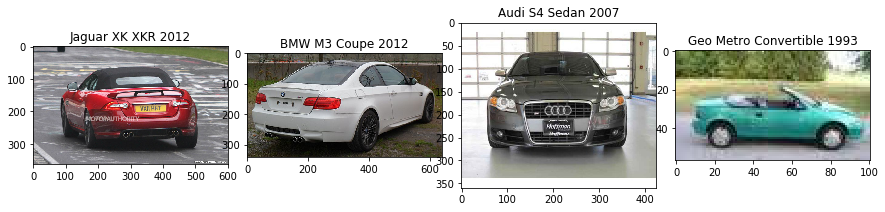

In [106]:
fig, axs = plt.subplots(1,4, figsize=(15, 6))
fig.subplots_adjust(hspace = 1, wspace=.1)
axs = axs.ravel()

for x in range(4):
    image, title = display_image(df_train_with_label, x+40)
    axs[x].imshow(image)
    axs[x].set_title(title)

plt.show();

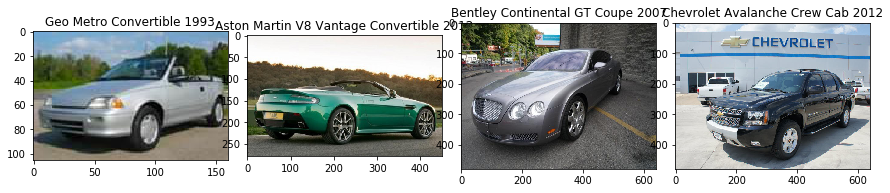

In [107]:
fig, axs = plt.subplots(1,4, figsize=(15, 6))
fig.subplots_adjust(hspace = 1, wspace=.1)
axs = axs.ravel()

for x in range(4):
    image, title = display_image(df_train_with_label, x+20)
    axs[x].imshow(image)
    axs[x].set_title(title)

plt.show();

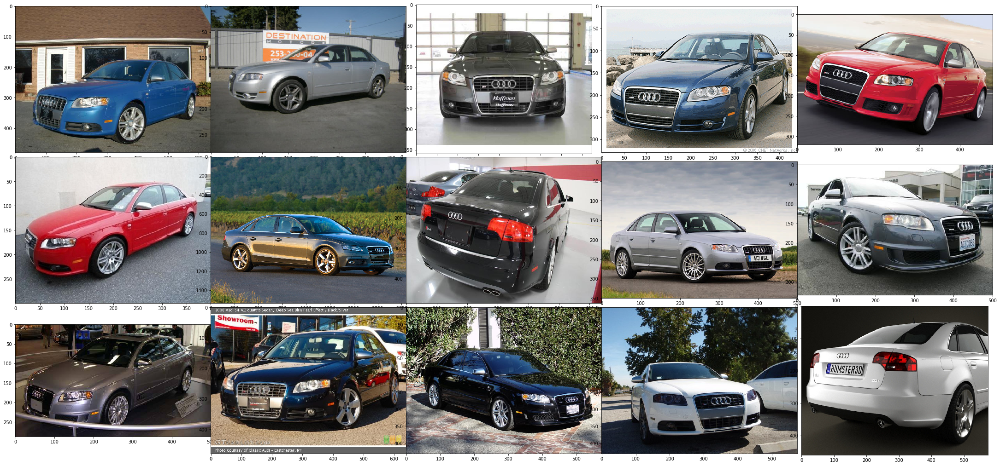

In [123]:
selected_df = df_train_with_label[df_train_with_label.labels == 'Audi S4 Sedan 2007'].reset_index()
len(selected_df)
selected_df.head()

fig, axs = plt.subplots(3,5, figsize=(38,18))
fig.subplots_adjust(hspace = .01, wspace=.0001)
axs = axs.ravel()

for x in range(15):
    image, title = display_image(selected_df, x)
    axs[x].imshow(image)
    
plt.show();

48


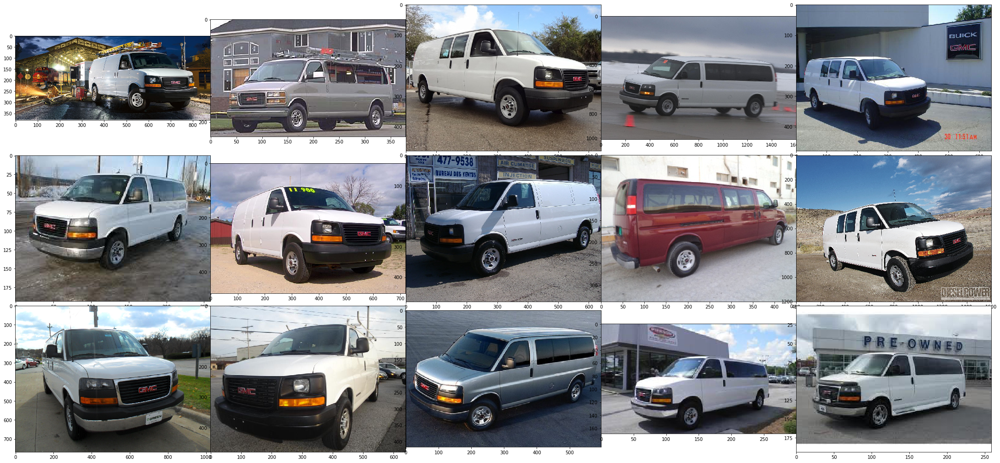

In [144]:
selected_df = df_train_with_label[df_train_with_label.labels == 'GMC Savana Van 2012'].reset_index()

fig, axs = plt.subplots(3,5, figsize=(38,18))
fig.subplots_adjust(hspace = .01, wspace=.0001)
axs = axs.ravel()

for x in range(15):
    image, title = display_image(selected_df, x)
    axs[x].imshow(image)
    
print(len(selected_df))
plt.show();

32


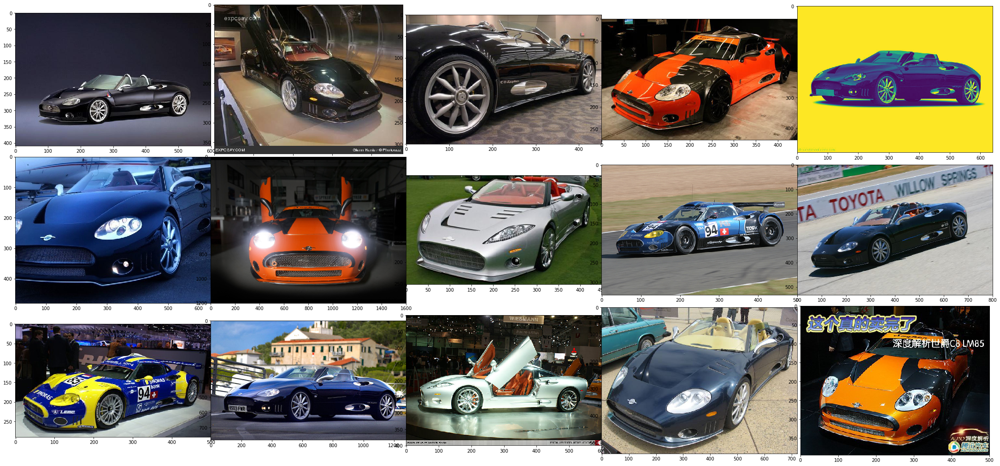

In [149]:
selected_df = df_train_with_label[df_train_with_label.labels == 'Spyker C8 Convertible 2009'].reset_index()

fig, axs = plt.subplots(3,5, figsize=(38,18))
fig.subplots_adjust(hspace = .01, wspace=.0001)
axs = axs.ravel()

for x in range(15):
    image, title = display_image(selected_df, x)
    axs[x].imshow(image)

print(len(selected_df))
plt.show();

32


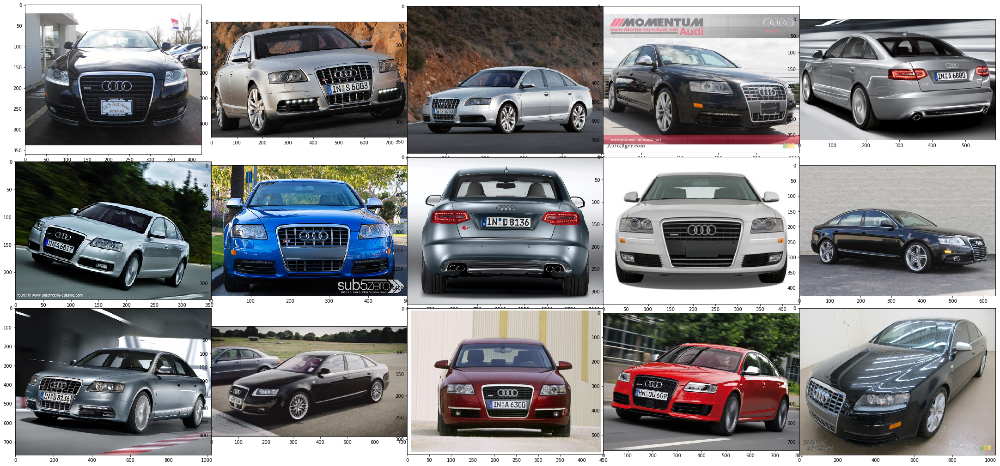

In [151]:
selected_df = df_train_with_label[df_train_with_label.labels == 'Audi S6 Sedan 2011'].reset_index()

fig, axs = plt.subplots(3,5, figsize=(38,18))
fig.subplots_adjust(hspace = .01, wspace=.0001)
axs = axs.ravel()

for x in range(15):
    image, title = display_image(selected_df, x)
    axs[x].imshow(image)

print(len(selected_df))
plt.show();

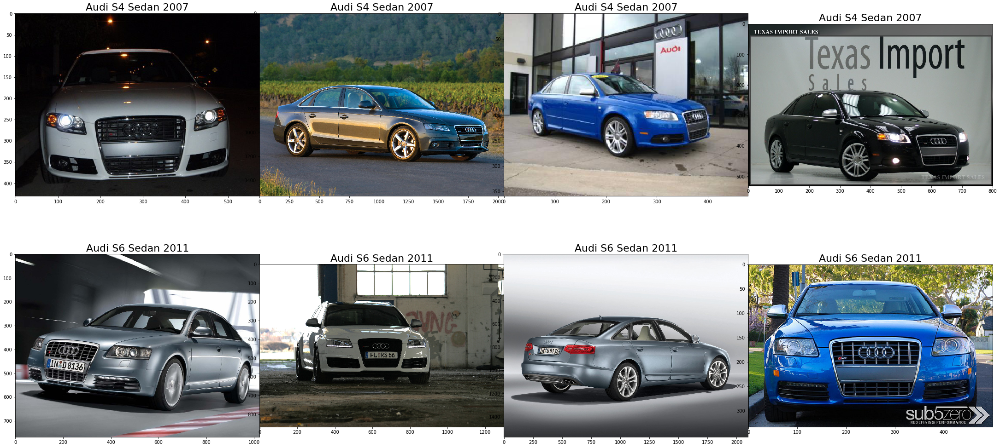

In [46]:
class_list = ['Audi S4 Sedan 2007', 'Audi S6 Sedan 2011']

fig, axs = plt.subplots(2,4, figsize=(38,18))
fig.subplots_adjust(hspace = .15, wspace=.0001)
axs = axs.ravel()

num_of_axes = 0
for index, c in enumerate(class_list):
    selected = os.listdir('test/'+c+'/')[2:]

    for x in range(4):
        image = Image.open('test/'+c+'/'+selected[x])
        title = c
        
        axs[num_of_axes].imshow(image)
        axs[num_of_axes].set_title(title, {'fontsize': 22})
        num_of_axes += 1

plt.show();

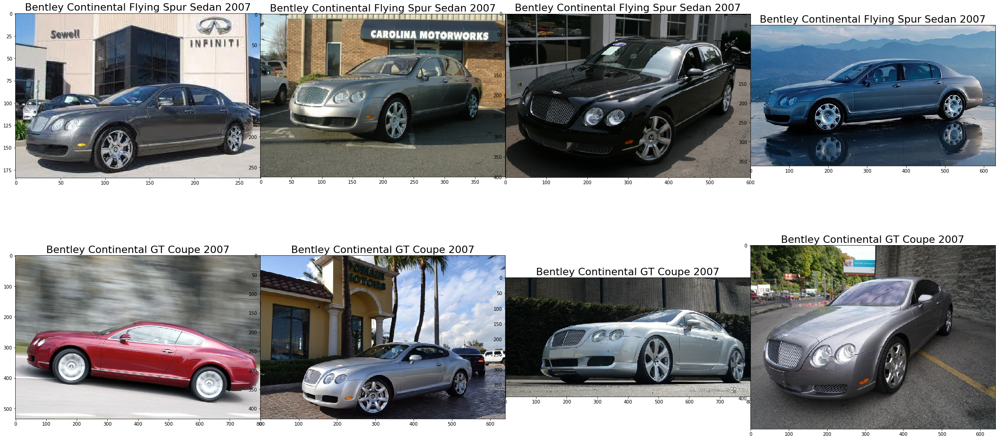

In [45]:
class_list = ['Bentley Continental Flying Spur Sedan 2007', 'Bentley Continental GT Coupe 2007']

fig, axs = plt.subplots(2,4, figsize=(38,18))
fig.subplots_adjust(hspace = .15, wspace=.0001)
axs = axs.ravel()

num_of_axes = 0
for index, c in enumerate(class_list):
    selected = os.listdir('test/'+c+'/')

    for x in range(4):
        image = Image.open('test/'+c+'/'+selected[x])
        title = c
        
        axs[num_of_axes].imshow(image)
        axs[num_of_axes].set_title(title, {'fontsize': 22})
        num_of_axes += 1

plt.show();

In [217]:
df_train_selected = df_train[df_train.label.isin(get_labels)]

selected_train = pd.DataFrame(df_train_selected[df_train_selected.filename.isin(X_train)].labels.value_counts())
selected_valid = pd.DataFrame(df_train_selected[df_train_selected.filename.isin(X_valid)].labels.value_counts())
selected_test = pd.DataFrame(df_train_selected[df_train_selected.filename.isin(X_test)].labels.value_counts())

selected_train.index.name = 'label'
selected_valid.index.name = 'label'
selected_test.index.name = 'label'

selected_2 = pd.merge(selected_train, selected_valid, on='label', suffixes=('_train', '_valid'))
selected_3 = pd.merge(selected_2, selected_test, on='label')

In [222]:
selected_3.rename(columns={'labels': 'labels_test'}).to_excel("cars.xlsx")

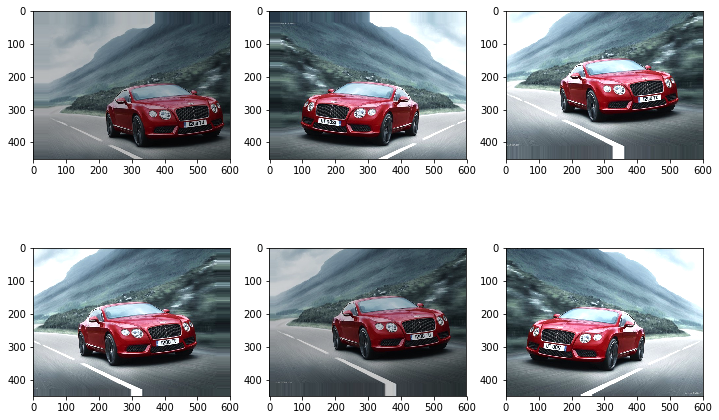

In [23]:
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from numpy import expand_dims
from matplotlib import pyplot
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import os
from tensorflow.keras.applications.xception import preprocess_input as preprocess_input_Xception
# augment_param = {'brightness_range':[0.2,2.2]} 
# augment_param = {'zoom_range':[0.2,2.2]} 
# augment_param = {'zoom_range':[0.2,0.8]}
# augment_param = {'rotation_range':135}
# augment_param = {'horizontal_flip':True}
# augment_param = {'vertical_flip':True} 
# augment_param = {'width_shift_range':0.5} 
# augment_param = {'height_shift_range':0.5} 
# augment_param = {'zca_whitening':True}
# augment_param = {'preprocessing_function':get_random_eraser(p=0.8, v_l=0, v_h=0.4, pixel_level=False)}
# https://arxiv.org/pdf/1708.04896.pdf

# elastic_transform(kot, alpha = kot.shape[1] * 3, sigma = kot.shape[1] * 0.07)

augment_param = {'brightness_range':[0.75,1.25],
                'horizontal_flip': True,
                'width_shift_range':50,
                'height_shift_range':50,
                'fill_mode': 'nearest',
                 'zca_whitening':True,
#                 'rescale':1./255,
#                 'preprocessing_function':preprocess_input_Xception,
                }

path = os.path.join("C:\\", "Users", "jazzu", "cars", "train", "Bentley Continental GT Coupe 2007", '01935.jpg')
img = load_img(path)
data = img_to_array(img)
samples = expand_dims(data, 0)

datagen = ImageDataGenerator(**augment_param)
it = datagen.flow(samples, batch_size=1)

pyplot.figure(figsize=(12,8))
for i in range(6):
    pyplot.subplot(230 + 1 + i)
    batch = it.next()
    image = batch[0].astype('uint8')
    pyplot.imshow(image)

pyplot.show()